# What drives the price of a car?

![](images/kurt.jpeg)

**OVERVIEW**

In this application, you will explore a dataset from Kaggle. The original dataset contained information on 3 million used cars. The provided dataset contains information on 426K cars to ensure speed of processing.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications, we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

### Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary.

###Our tast is to determine, what do customers value in a used car? Our answer will come in the form of the names of several features of our dataset that we conclude to hold the most significance or in other words, have the most correlation, with our target variable. We will go through several steps to solve this problem. The first is making sure we have a very solid understanding of the real question we are being asked.

### Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

Here will be our first look at the dataset itself. There will be several things that we will want to explore including, the structure of the dataset, what different datatypes it has, and missing values or poorly recored data it might contain. In addition, we will need to begin constructing some visualizations to aid us in our understanding of our dataset.

In [1]:
# Begin by importing the libraries that we will be using
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px
from sklearn.linear_model import Ridge, Lasso
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.decomposition import PCA
from sklearn.feature_selection import SequentialFeatureSelector

In [2]:
# Reading our csv file into a pandas DataFrame
filename = '/content/vehicles.csv'
df = pd.read_csv(filename)
df

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
0,7222695916,prescott,6000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,az
1,7218891961,fayetteville,11900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ar
2,7221797935,florida keys,21000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fl
3,7222270760,worcester / central MA,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ma
4,7210384030,greensboro,4900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nc
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
426875,7301591192,wyoming,23590,2019.0,nissan,maxima s sedan 4d,good,6 cylinders,gas,32226.0,clean,other,1N4AA6AV6KC367801,fwd,NaN,sedan,NaN,wy
426876,7301591187,wyoming,30590,2020.0,volvo,s60 t5 momentum sedan 4d,good,NaN,gas,12029.0,clean,other,7JR102FKXLG042696,fwd,NaN,sedan,red,wy
426877,7301591147,wyoming,34990,2020.0,cadillac,xt4 sport suv 4d,good,NaN,diesel,4174.0,clean,other,1GYFZFR46LF088296,NaN,NaN,hatchback,white,wy
426878,7301591140,wyoming,28990,2018.0,lexus,es 350 sedan 4d,good,6 cylinders,gas,30112.0,clean,other,58ABK1GG4JU103853,fwd,NaN,sedan,silver,wy


In [3]:
# Listing our data types
df.dtypes

,0
id,int64
region,object
price,int64
year,float64
manufacturer,object
model,object
condition,object
cylinders,object
fuel,object
odometer,float64


The above cell tells us that our data is mostly of a categorical type.

In [4]:
# Describe our data
df.describe(include='all')

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
count,4.268800e+05,426880,4.268800e+05,425675.000000,409234,421603,252776,249202,423867,4.224800e+05,418638,424324,265838,296313,120519,334022,296677,426880
unique,NaN,404,NaN,NaN,42,29649,6,8,5,NaN,6,3,118246,3,4,13,12,51
top,NaN,columbus,NaN,NaN,ford,f-150,good,6 cylinders,gas,NaN,clean,automatic,1FMJU1JT1HEA52352,4wd,full-size,sedan,white,ca
freq,NaN,3608,NaN,NaN,70985,8009,121456,94169,356209,NaN,405117,336524,261,131904,63465,87056,79285,50614
mean,7.311487e+09,NaN,7.519903e+04,2011.235191,NaN,NaN,NaN,NaN,NaN,9.804333e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,4.473170e+06,NaN,1.218228e+07,9.452120,NaN,NaN,NaN,NaN,NaN,2.138815e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,7.207408e+09,NaN,0.000000e+00,1900.000000,NaN,NaN,NaN,NaN,NaN,0.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,7.308143e+09,NaN,5.900000e+03,2008.000000,NaN,NaN,NaN,NaN,NaN,3.770400e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,7.312621e+09,NaN,1.395000e+04,2013.000000,NaN,NaN,NaN,NaN,NaN,8.554800e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,7.315254e+09,NaN,2.648575e+04,2017.000000,NaN,NaN,NaN,NaN,NaN,1.335425e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
df.columns # Listing all features

Index(['id', 'region', 'price', 'year', 'manufacturer', 'model', 'condition',
       'cylinders', 'fuel', 'odometer', 'title_status', 'transmission', 'VIN',
       'drive', 'size', 'type', 'paint_color', 'state'],
      dtype='object')

In [6]:
df['price'].isna().value_counts() # Price will be the variable that wer will try and predict.

,count
price,
False,426880


In [7]:
# Looking at how many missing values we have per feature
missing_vals = df.isnull().sum().sort_values()
print(missing_vals)

id                   0
price                0
state                0
region               0
year              1205
transmission      2556
fuel              3013
odometer          4400
model             5277
title_status      8242
manufacturer     17646
type             92858
paint_color     130203
drive           130567
VIN             161042
condition       174104
cylinders       177678
size            306361
dtype: int64


In [8]:
# Count the number of null values in each row
null_count_per_row = df.isnull().sum(axis=1)

# Find rows with more than 5 null values
rows_with_more_than_5_nulls = null_count_per_row[null_count_per_row > 5]

# Get the number of such rows
num_rows_with_more_than_5_nulls = rows_with_more_than_5_nulls.count()

print(f'Number of rows with more than 5 null values: {num_rows_with_more_than_5_nulls}')

Number of rows with more than 5 null values: 54724


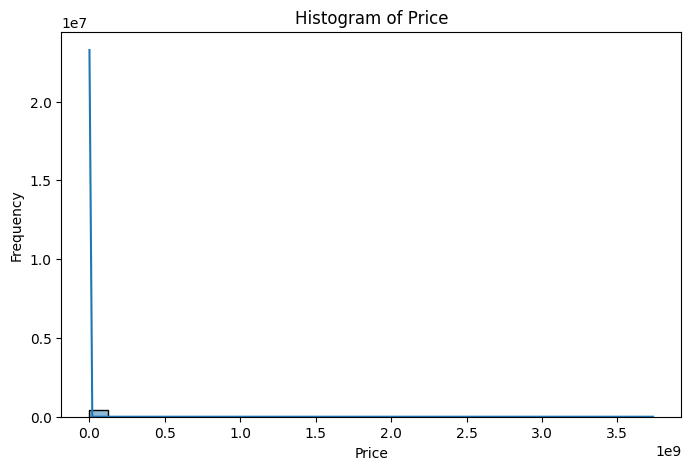

In [9]:
# Looking at the distribution of prices
plt.figure(figsize=(8,5))
sns.histplot(df['price'], bins=30, kde=True)
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.title('Histogram of Price')
plt.show()


This initial Histogram provides more questions than answers about our dependent variable. I am hypothesizing that this feature might have some values of 0 as well as some high outliers that are skewing our histogram.

In [10]:
df['price'].describe()

,price
count,4.268800e+05
mean,7.519903e+04
std,1.218228e+07
min,0.000000e+00
25%,5.900000e+03
50%,1.395000e+04
75%,2.648575e+04
max,3.736929e+09


In [11]:
(df['price'] == 0).sum() # Number of rows with price equal to zero

32895

In [12]:
df['price'].max()

3736928711

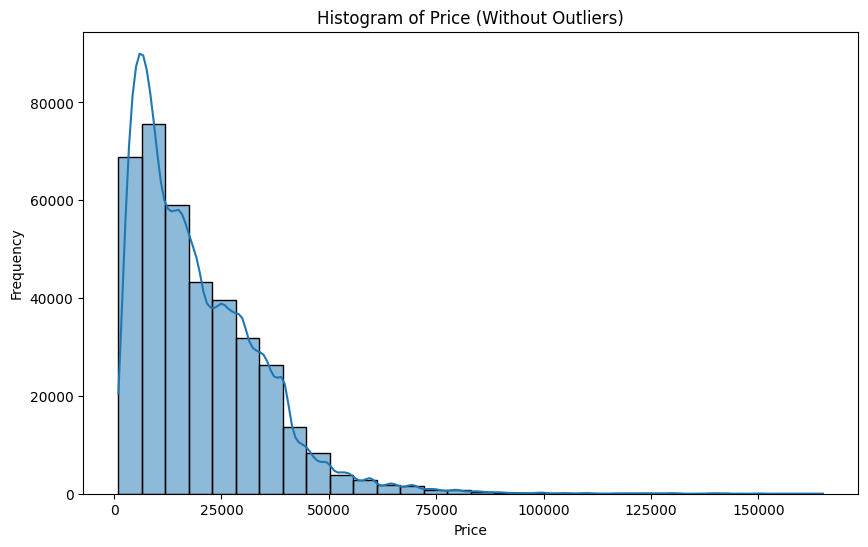

In [13]:
# Step 1: Calculate the IQR (Interquartile Range)
Q1 = df['price'].quantile(0.01)
Q3 = df['price'].quantile(0.99)
IQR = Q3 - Q1

# Step 2: Filter out the outliers (values outside the range of Q1 - 1.5*IQR to Q3 + 1.5*IQR)
df_no_outliers = df[(df['price'] >= (Q1 - 1.5 * IQR)) & (df['price'] <= (Q3 + 1.5 * IQR))]
df_no_outliers_no_zeros = df_no_outliers[df_no_outliers['price'] > 1000] # Set this to be a small positive value.

# Step 3: Plot the histogram without outliers
plt.figure(figsize=(10, 6))
sns.histplot(df_no_outliers_no_zeros['price'], kde=True, bins=30)
plt.title('Histogram of Price (Without Outliers)')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.show()

In our Data Preparation phase we will certainly have to take out all of the zero values from 'price'. One of the biggest qestions will be how to deal with the shear quantity of null values we have.

In [14]:
df_numeric = df.select_dtypes(include=['number'])
df_numeric.corr() # Looking at correlation of our numeric features

,id,price,year,odometer
id,1.000000,-0.002779,-0.059040,0.010721
price,-0.002779,1.000000,-0.004925,0.010032
year,-0.059040,-0.004925,1.000000,-0.157215
odometer,0.010721,0.010032,-0.157215,1.000000


In [15]:
# Step 1: Calculate the IQR (Interquartile Range)
Q1 = df['price'].quantile(0.25)
Q3 = df['price'].quantile(0.75)
IQR = Q3 - Q1

# Step 2: Filter out the outliers (values outside the range of Q1 - 1.5*IQR to Q3 + 1.5*IQR)
df_no_outliers = df[(df['price'] >= (Q1 - 1.5 * IQR)) & (df['price'] <= (Q3 + 1.5 * IQR))]

In [16]:
df['odometer'].describe()

,odometer
count,4.224800e+05
mean,9.804333e+04
std,2.138815e+05
min,0.000000e+00
25%,3.770400e+04
50%,8.554800e+04
75%,1.335425e+05
max,1.000000e+07


In [17]:
fig = px.scatter(df_no_outliers, x='year', y='price', title='Price vs Year', color='odometer', trendline='ols')
fig.show()

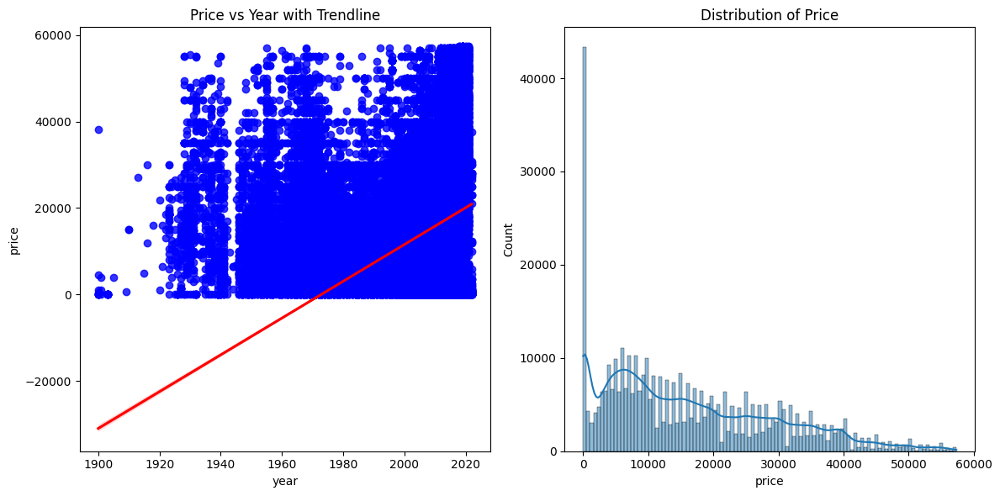

In [18]:
fig, ax = plt.subplots(1,2, figsize=(12,6)) # Figure with 1 row and 2 columns

sns.regplot(x='year', y='price', data=df_no_outliers, ax=ax[0], scatter_kws={'color': 'blue'}, line_kws={'color': 'red'})
ax[0].set_title('Price vs Year with Trendline')


sns.histplot(df_no_outliers['price'], kde=True, ax=ax[1])
ax[1].set_title('Distribution of Price')

plt.tight_layout()

plt.show()

In [19]:
# Sorting by price
df.sort_values(by='price', ascending=False).head(10) # Notice lots of values where the price is extremely high.

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
318592,7308056031,eugene,3736928711,2007.0,toyota,tundra,excellent,8 cylinders,gas,164000.0,clean,automatic,NaN,4wd,full-size,pickup,silver,or
356716,7302445002,knoxville,3736928711,1999.0,toyota,4runner,fair,6 cylinders,gas,211000.0,clean,automatic,NaN,4wd,mid-size,NaN,green,tn
257840,7309735768,south jersey,3024942282,2000.0,mercedes-benz,benz s430,NaN,NaN,gas,100000.0,clean,automatic,NaN,NaN,NaN,NaN,NaN,nj
91576,7309730903,delaware,3024942282,2000.0,mercedes-benz,benz e320,NaN,NaN,gas,100000.0,clean,automatic,NaN,NaN,NaN,NaN,NaN,de
37410,7314052904,modesto,3009548743,2021.0,chevrolet,NaN,NaN,8 cylinders,gas,1000.0,clean,automatic,NaN,4wd,NaN,NaN,NaN,ca
184704,7304345156,frederick,1410065407,1989.0,jeep,wrangler,NaN,NaN,diesel,103000.0,clean,manual,NaN,NaN,NaN,SUV,NaN,md
153082,7305153975,indianapolis,1234567890,2006.0,volvo,vnl,fair,NaN,other,200000.0,clean,manual,NaN,NaN,NaN,NaN,black,in
29386,7305265540,humboldt county,1111111111,1999.0,ford,f350 super duty lariat,good,8 cylinders,diesel,149000.0,clean,automatic,NaN,rwd,full-size,pickup,white,ca
37409,7314053169,modesto,1111111111,2020.0,jeep,NaN,NaN,NaN,gas,1000.0,clean,automatic,NaN,4wd,NaN,NaN,NaN,ca
122470,7315836487,atlanta,987654321,1960.0,chevrolet,NaN,NaN,NaN,gas,9999999.0,clean,manual,NaN,NaN,NaN,NaN,NaN,ga


In [20]:
df.sort_values(by='price', ascending=True) # Notice lots of Values where price is equal to zero

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
335266,7307704873,philadelphia,0,2012.0,infiniti,g37x awd,NaN,NaN,gas,131922.0,clean,automatic,NaN,NaN,NaN,NaN,NaN,pa
97994,7316671228,jacksonville,0,2016.0,ford,f-150,NaN,NaN,NaN,NaN,NaN,NaN,1FTEW1CF0GFA87903,NaN,NaN,NaN,NaN,fl
97995,7316671091,jacksonville,0,2016.0,mercedes-benz,c-class,NaN,NaN,NaN,NaN,NaN,NaN,55SWF4JB7GU157731,NaN,NaN,NaN,NaN,fl
97996,7316670635,jacksonville,0,2017.0,toyota,camry,like new,6 cylinders,gas,80000.0,clean,automatic,NaN,fwd,full-size,sedan,silver,fl
356355,7304587188,knoxville,0,2008.0,nissan,armada se,good,8 cylinders,gas,224444.0,clean,automatic,5N1AA08D38N613507,rwd,NaN,SUV,NaN,tn
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37410,7314052904,modesto,3009548743,2021.0,chevrolet,NaN,NaN,8 cylinders,gas,1000.0,clean,automatic,NaN,4wd,NaN,NaN,NaN,ca
91576,7309730903,delaware,3024942282,2000.0,mercedes-benz,benz e320,NaN,NaN,gas,100000.0,clean,automatic,NaN,NaN,NaN,NaN,NaN,de
257840,7309735768,south jersey,3024942282,2000.0,mercedes-benz,benz s430,NaN,NaN,gas,100000.0,clean,automatic,NaN,NaN,NaN,NaN,NaN,nj
318592,7308056031,eugene,3736928711,2007.0,toyota,tundra,excellent,8 cylinders,gas,164000.0,clean,automatic,NaN,4wd,full-size,pickup,silver,or


<Axes: xlabel='year', ylabel='price'>

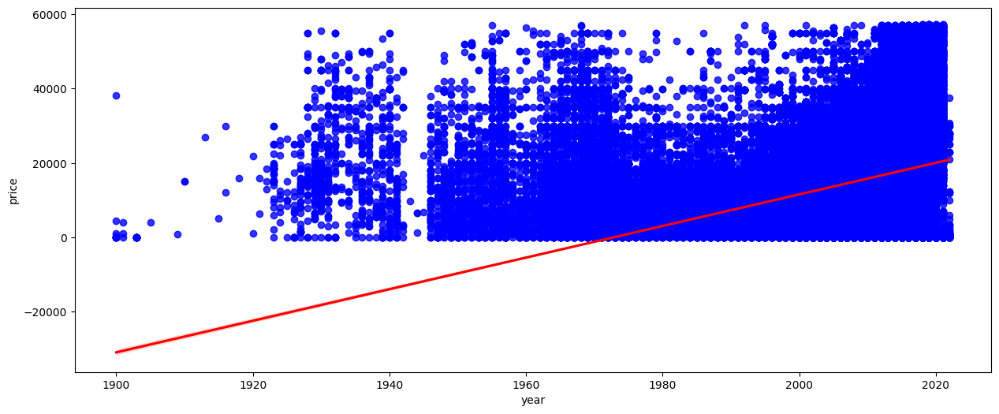

In [21]:
fig = plt.figure(figsize=(15, 6))
sns.regplot(x='year', y='price', data=df_no_outliers, scatter_kws={'color': 'blue'}, line_kws={'color': 'red'})


In [22]:
# Making a distribution of the numbers of each car condition.

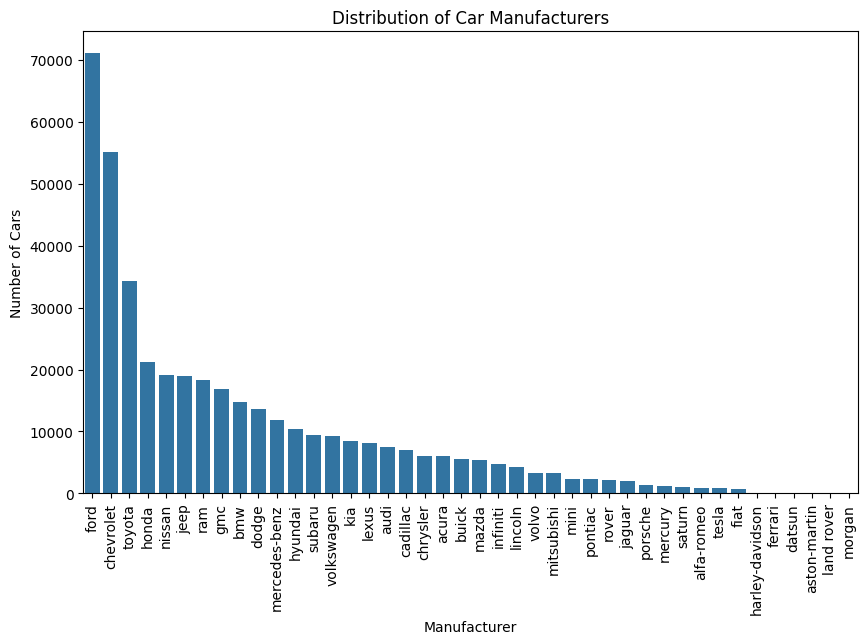

In [23]:
man_order = df['manufacturer'].value_counts().index # Sort to show manufacturer from most to least common
plt.figure(figsize=(10, 6))


sns.countplot(x='manufacturer', data=df, order=man_order)
plt.xticks(rotation=90)
plt.title('Distribution of Car Manufacturers')
plt.xlabel('Manufacturer')
plt.ylabel('Number of Cars')
plt.show()

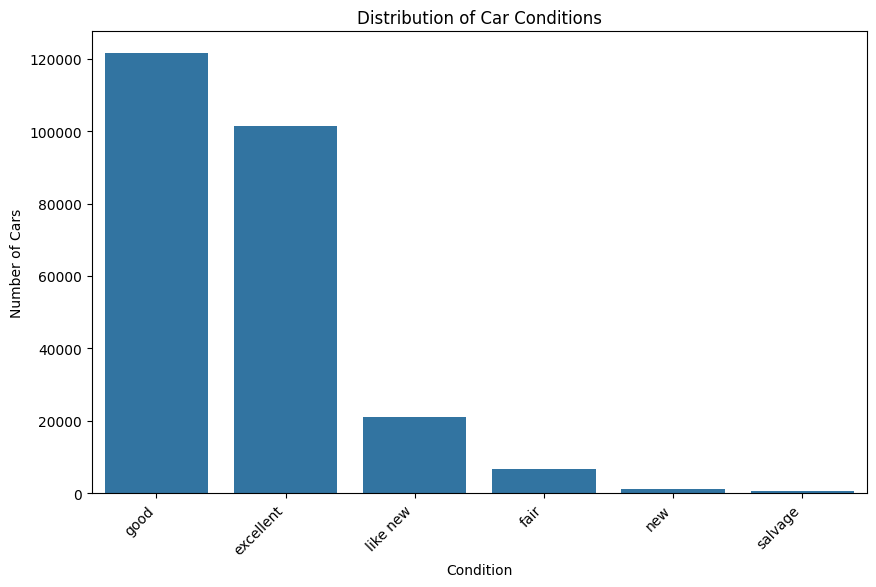

In [24]:
condition_order = df['condition'].value_counts().index # Sort to show condition from most to least common


plt.figure(figsize=(10, 6))  # Adjust figure size if needed
sns.countplot(x='condition', data=df, order=condition_order)
plt.title('Distribution of Car Conditions')
plt.xlabel('Condition')
plt.ylabel('Number of Cars')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels if they are long
plt.show()


### Data Preparation

After our initial exploration and fine-tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`.

In [25]:
# show me the number of cars whose price is less than 1000
df[df['price'] < 500].value_counts().sum() # Here

3167

In [26]:
df.query('price < 500 & price > 50').groupby('condition').size() # Shows us the number of cars between $50 and $500 based on their condition.

,0
condition,
excellent,1248
fair,46
good,340
like new,290
new,68
salvage,32


Referring to the above cell. I do not think it makes sense that the vast majority of cars between the price of #500 and $50 fall into the Excellent, good, or like new categories. When I filter my dataframe. I will set 500 to my lower bound.

In [27]:
print(df.select_dtypes(include=['number'])) # Display numeric features

                id  price    year  odometer
0       7222695916   6000     NaN       NaN
1       7218891961  11900     NaN       NaN
2       7221797935  21000     NaN       NaN
3       7222270760   1500     NaN       NaN
4       7210384030   4900     NaN       NaN
...            ...    ...     ...       ...
426875  7301591192  23590  2019.0   32226.0
426876  7301591187  30590  2020.0   12029.0
426877  7301591147  34990  2020.0    4174.0
426878  7301591140  28990  2018.0   30112.0
426879  7301591129  30590  2019.0   22716.0

[426880 rows x 4 columns]


In [28]:
# Here I am going to create a dataframe in which we exclude the upper and lower quantiles from our numeric variable

# Define filtering conditions
lower_bound = 500 # I will assign this to be 500 based on the cell above
upper_bound = df['price'].quantile(0.99) # 99th percentile

df_filtered = df[
    (df['price'] > lower_bound) & (df['price'] <= upper_bound) &  # Filter price
    (df['year'] < df['year'].quantile(0.99)) & (df['year'] > df['year'].quantile(0.01)) &  # Filter year
    (df['odometer'] < df['odometer'].quantile(0.99)) & (df['odometer'] > df['odometer'].quantile(0.01))  # Filter odometer
]

print(f'Price min: {df_filtered["price"].min()}')
print(f'Price max: {df_filtered["price"].max()}')
print(f'Year min: {df_filtered["year"].min()}')
print(f'Year max: {df_filtered["year"].max()}')
print(f'Odometer max: {df_filtered["odometer"].max()}')
print(f'Odometer min: {df_filtered["odometer"].min()}')

Price min: 501
Price max: 66995
Year min: 1968.0
Year max: 2019.0
Odometer max: 279974.0
Odometer min: 3.0


In [29]:
df_filtered.shape

(348681, 18)

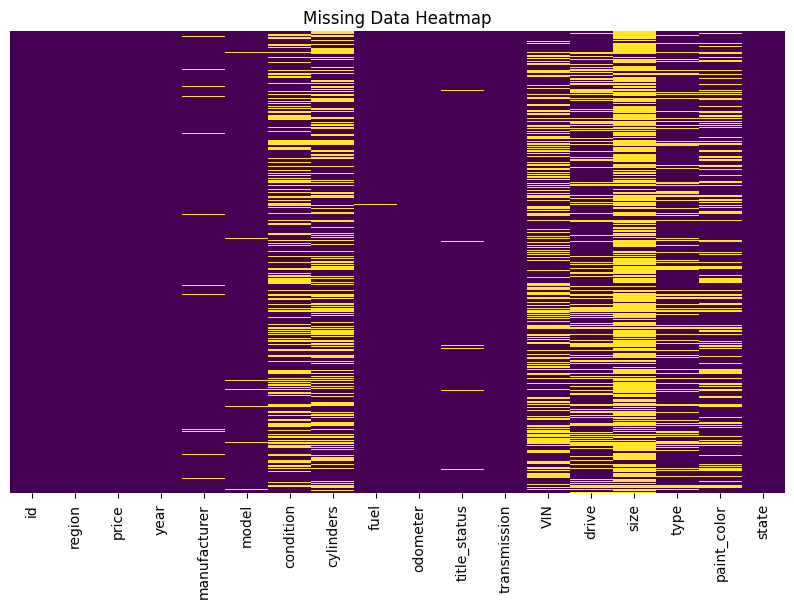

In [30]:
# Visualize missing values
plt.figure(figsize=(10, 6))
sns.heatmap(df_filtered.isnull(), cmap='viridis', cbar=False, yticklabels=False)
plt.title('Missing Data Heatmap')
plt.show()

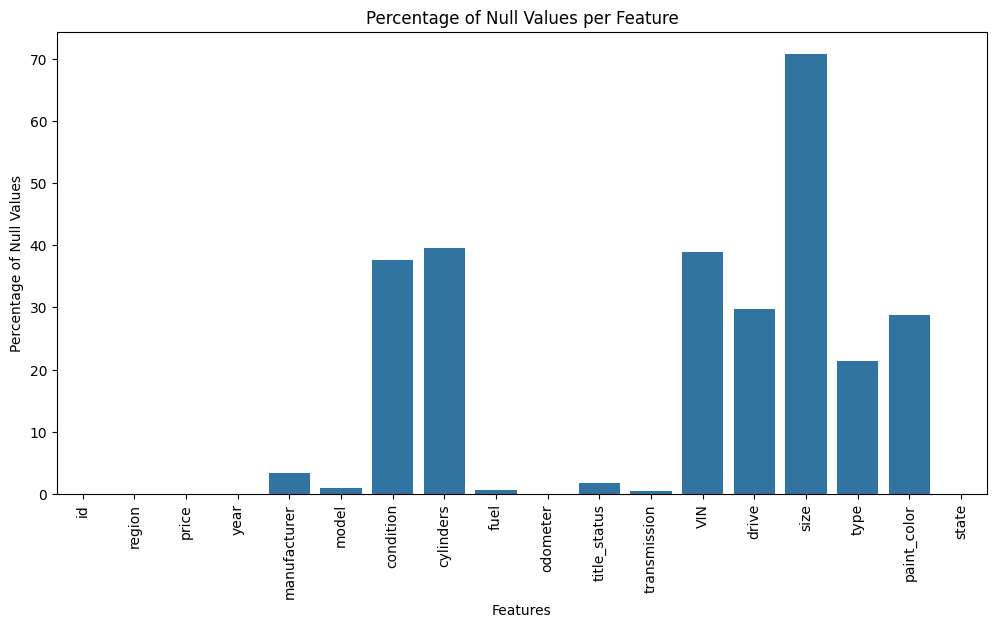

In [31]:
# Calculate the percentage of null values for each feature
null_percentage = df_filtered.isnull().sum() * 100 / len(df_filtered)

# Create a bar plot
plt.figure(figsize=(12, 6))
sns.barplot(x=null_percentage.index, y=null_percentage.values)
plt.xticks(rotation=90)
plt.xlabel('Features')
plt.ylabel('Percentage of Null Values')
plt.title('Percentage of Null Values per Feature')
plt.show()


In [32]:
# I am going to drop some columns that either be will be erroneous to predicting price or have too high a percentage of null values.
df_filtered = df_filtered.drop(columns=['size', 'VIN', 'id'])

In [33]:
df_filtered.dropna(subset=['year', 'price', 'odometer'], inplace=True) # Dropping nulls from our numeric features

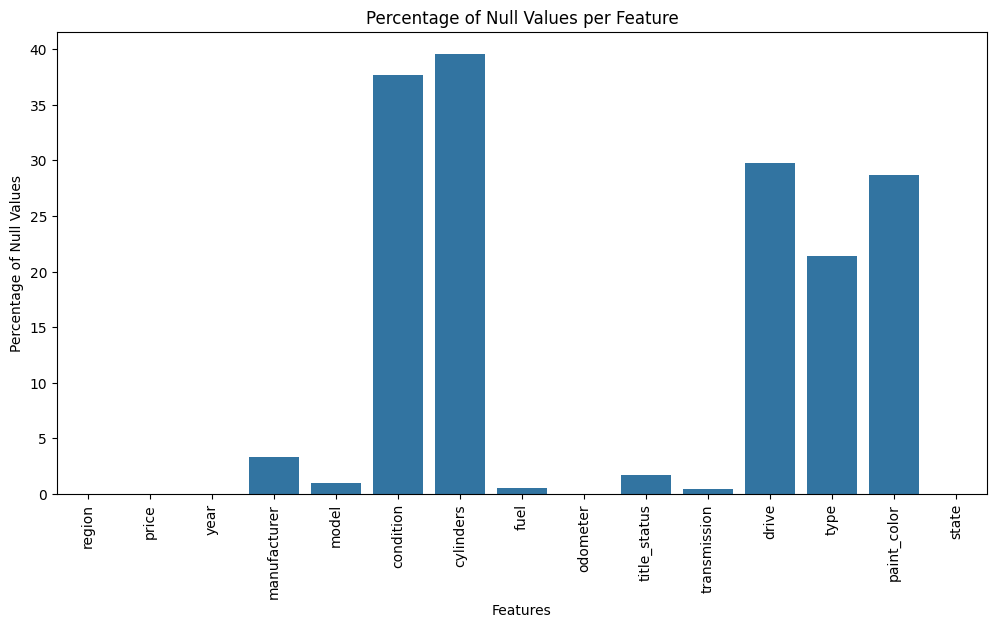

In [34]:
# Calculate the percentage of null values for each feature
null_percentage = df_filtered.isnull().sum() * 100 / len(df_filtered)

# Create a bar plot
plt.figure(figsize=(12, 6))
sns.barplot(x=null_percentage.index, y=null_percentage.values)
plt.xticks(rotation=90)
plt.xlabel('Features')
plt.ylabel('Percentage of Null Values')
plt.title('Percentage of Null Values per Feature')
plt.show()

In [35]:
# Removing rows with missing values in specific columns
columns_to_remove_na = ['transmission', 'manufacturer', 'fuel', 'title_status', 'model']
initial_rows = len(df_filtered)

for col in columns_to_remove_na:
    df_filtered = df_filtered[df_filtered[col].notna()]  # Remove rows where the column is NaN

# Replacing NaN values with 'unknown' for categorical features
columns_to_fill_unknown = ['condition', 'fuel','drive', 'type', 'paint_color', 'state']

for col in columns_to_fill_unknown:
    df_filtered[col] = df_filtered[col].fillna('unknown')
    print(f"{col} distinct values:", df_filtered[col].unique(), "\n")

# Handling 'cylinders' column separately
df_filtered['cylinders'] = df_filtered['cylinders'].fillna('unknown').replace('other', 'unknown')  # Replace NaN and "other"
df_filtered = df_filtered[df_filtered['cylinders'] != 'unknown'].copy()  # Drop rows where cylinders = 'unknown'
df_filtered['cylinders'] = df_filtered['cylinders'].str.replace('cylinders', '', regex=True).str.strip()  # Remove text
df_filtered['cylinders'] = pd.to_numeric(df_filtered['cylinders'], errors='coerce')  # Convert to numeric (only care about number of cylinders)
print("cylinders distinct values:", df_filtered['cylinders'].unique(), "\n")

condition distinct values: ['good' 'excellent' 'fair' 'like new' 'new' 'unknown' 'salvage'] 

fuel distinct values: ['gas' 'other' 'diesel' 'hybrid' 'electric'] 

drive distinct values: ['unknown' 'rwd' '4wd' 'fwd'] 

type distinct values: ['pickup' 'truck' 'other' 'unknown' 'coupe' 'hatchback' 'mini-van' 'SUV'
 'sedan' 'offroad' 'convertible' 'wagon' 'van' 'bus'] 

paint_color distinct values: ['white' 'blue' 'red' 'black' 'silver' 'grey' 'unknown' 'brown' 'yellow'
 'green' 'custom' 'orange' 'purple'] 

state distinct values: ['al' 'ak' 'az' 'ar' 'ca' 'co' 'ct' 'dc' 'de' 'fl' 'ga' 'hi' 'id' 'il'
 'in' 'ia' 'ks' 'ky' 'la' 'me' 'md' 'ma' 'mi' 'mn' 'ms' 'mo' 'mt' 'nc'
 'ne' 'nv' 'nj' 'nm' 'ny' 'nh' 'nd' 'oh' 'ok' 'or' 'pa' 'ri' 'sc' 'sd'
 'tn' 'tx' 'ut' 'vt' 'va' 'wa' 'wv' 'wi' 'wy'] 

cylinders distinct values: [ 8  6  4  5 10  3 12] 



In [36]:
# Make sure we have addressed all of the missing values.
df_filtered.isna().sum()

,0
region,0
price,0
year,0
manufacturer,0
model,0
condition,0
cylinders,0
fuel,0
odometer,0
title_status,0


The biggest challenge for me now is keeping my dimensionality in check. I need to one-hot-encode or oridnally-encode lots of the categorical features in my dataset. To simplify this, I am going to look at the frequencies of each of the categorical features and limit the unqiue values in each column to only those with the highest levels of frequency.

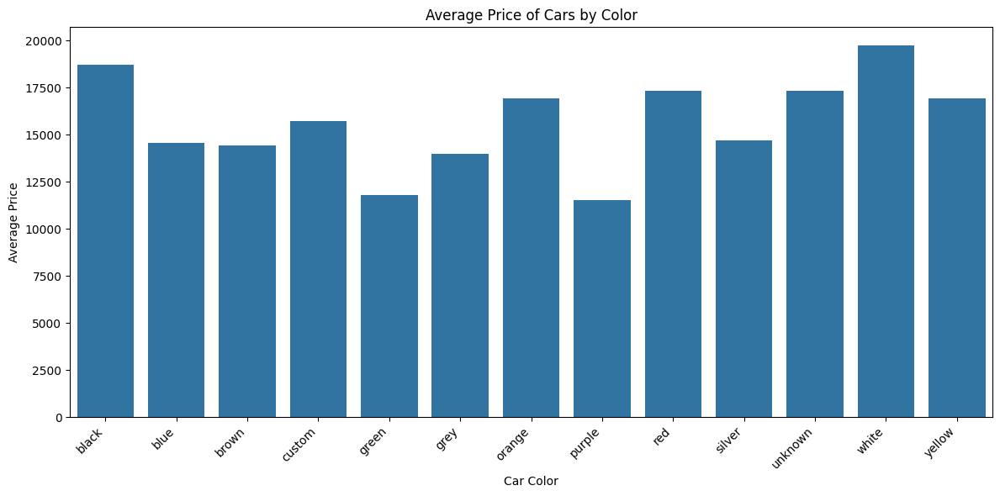

In [37]:
# Calculate average price per car color
avg_price_by_color = df_filtered.groupby('paint_color')['price'].mean()

# Create the bar chart
plt.figure(figsize=(12, 6))
sns.barplot(x=avg_price_by_color.index, y=avg_price_by_color.values)
plt.xlabel("Car Color")
plt.ylabel("Average Price")
plt.title("Average Price of Cars by Color")
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.tight_layout()
plt.show()


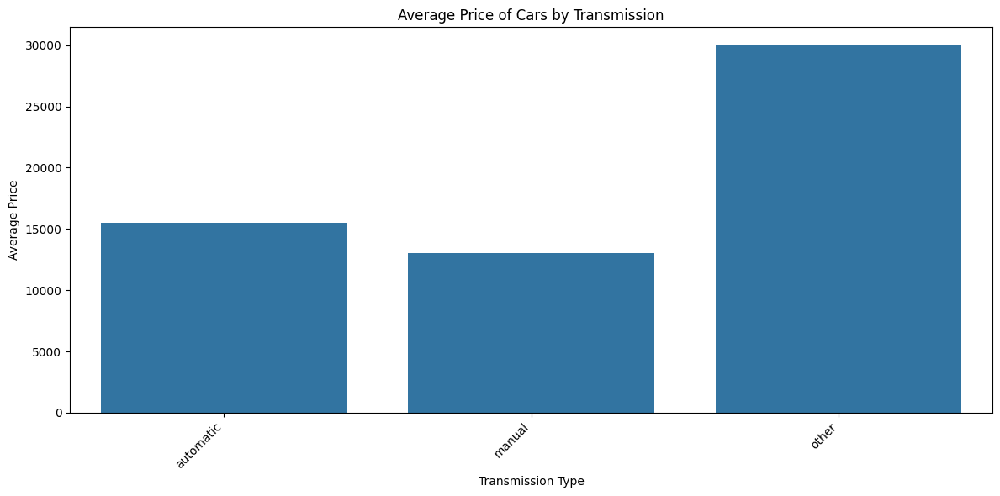

In [38]:
# Calculate average price per transmission type
avg_price_by_transmission = df_filtered.groupby('transmission')['price'].mean()

# Create the bar chart
plt.figure(figsize=(12, 6))
sns.barplot(x=avg_price_by_transmission.index, y=avg_price_by_transmission.values)
plt.xlabel("Transmission Type")
plt.ylabel("Average Price")
plt.title("Average Price of Cars by Transmission")
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.tight_layout()
plt.show()


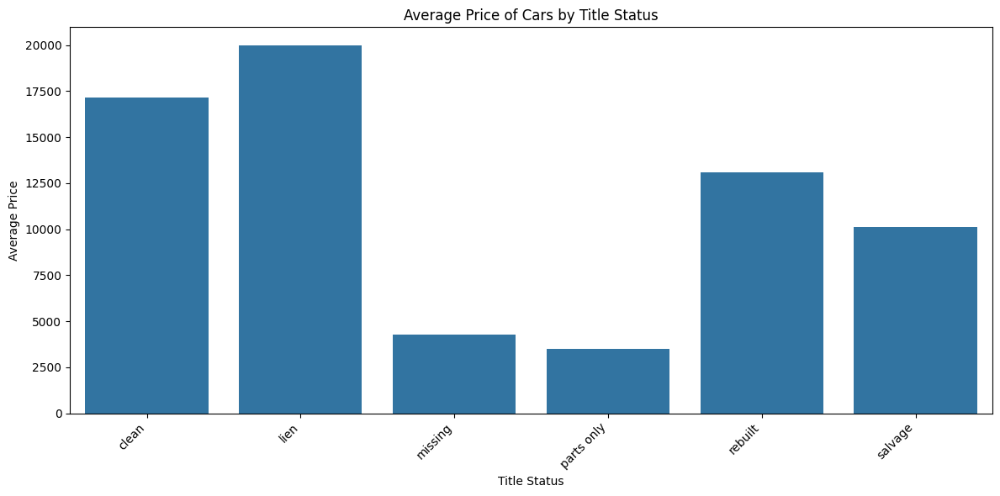

In [39]:
# Calculate average price per title_status
avg_price_by_title = df_filtered.groupby('title_status')['price'].mean()

# Create the bar chart
plt.figure(figsize=(12, 6))
sns.barplot(x=avg_price_by_title.index, y=avg_price_by_title.values)
plt.xlabel("Title Status")
plt.ylabel("Average Price")
plt.title("Average Price of Cars by Title Status")
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.tight_layout()
plt.show()


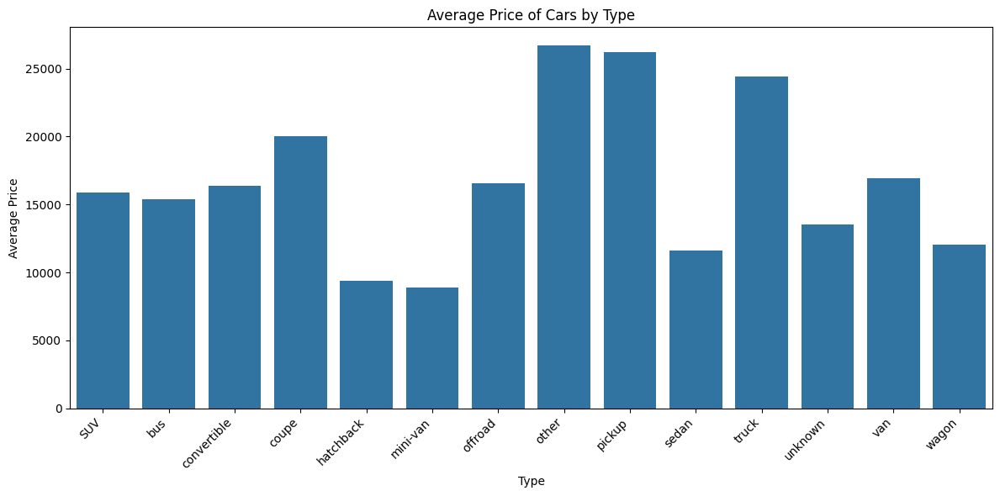

In [40]:
# Calculate average price per car type
avg_price_by_type = df_filtered.groupby('type')['price'].mean()

# Create the bar chart
plt.figure(figsize=(12, 6))
sns.barplot(x=avg_price_by_type.index, y=avg_price_by_type.values)
plt.xlabel("Type")
plt.ylabel("Average Price")
plt.title("Average Price of Cars by Type")
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.tight_layout()
plt.show()


In [41]:
df_filtered

,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,type,paint_color,state
27,auburn,33590,2014.0,gmc,sierra 1500 crew cab slt,good,8,gas,57923.0,clean,other,unknown,pickup,white,al
28,auburn,22590,2010.0,chevrolet,silverado 1500,good,8,gas,71229.0,clean,other,unknown,pickup,blue,al
30,auburn,30990,2017.0,toyota,tundra double cab sr,good,8,gas,41124.0,clean,other,unknown,pickup,red,al
31,auburn,15000,2013.0,ford,f-150 xlt,excellent,6,gas,128000.0,clean,automatic,rwd,truck,black,al
32,auburn,27990,2012.0,gmc,sierra 2500 hd extended cab,good,8,gas,68696.0,clean,other,4wd,pickup,black,al
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
426864,wyoming,29590,2016.0,toyota,4runner sr5 sport utility,good,6,gas,53475.0,clean,automatic,unknown,SUV,black,wy
426866,wyoming,32990,2016.0,infiniti,qx80 sport utility 4d,good,8,gas,55612.0,clean,automatic,rwd,other,black,wy
426874,wyoming,33590,2018.0,lexus,gs 350 sedan 4d,good,6,gas,30814.0,clean,automatic,rwd,sedan,white,wy
426875,wyoming,23590,2019.0,nissan,maxima s sedan 4d,good,6,gas,32226.0,clean,other,fwd,sedan,unknown,wy


In [42]:
clean_df = df_filtered.copy()
# Delete df_filtered2 to save ram
del df_filtered

In [43]:
# Apply the same filter to x and color
odometer_filtered = clean_df[clean_df['odometer'] < 400000]

# Now use the filtered DataFrame for all arguments
fig = px.scatter(
    x=clean_df['price'],
    y=clean_df['odometer'],  # Also update y to use the filtered price
    color=clean_df['price'],
    title='Price vs. Odometer with Density',
    labels = {'x':'Price', 'y':'Odometer'},
    trendline='ols',
    trendline_color_override='red'
)
fig.show()

In [44]:
# Now use the filtered DataFrame for all arguments
fig = px.scatter(
    x=clean_df['year'],
    y=clean_df['odometer'],  # Also update y to use the filtered price
    color=clean_df['price'],
    title='Odometer vs. Year with Density',
    labels = {'x':'Price', 'y':'Odometer'},
    trendline='ols',
    trendline_color_override='red'
)
fig.show()

In [45]:
# Now use the filtered DataFrame for all arguments
fig = px.scatter(
    x=clean_df['year'],
    y=clean_df['price'],  # Also update y to use the filtered price
    color=clean_df['price'],
    title='Year vs. Price with Density',
    labels = {'x':'Price', 'y':'Odometer'},
    trendline='ols',
    trendline_color_override='red'
)
fig.show()

### Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

In [46]:
# Begin by separating our numerical features.
numerical_features = ['year','odometer','cylinders', 'price']
numerical_features

['year', 'odometer', 'cylinders', 'price']

In [47]:
# Firstly we will look at some simple linear regressions with our numerical features.
numeric_df = clean_df[numerical_features]
numeric_df

,year,odometer,cylinders,price
27,2014.0,57923.0,8,33590
28,2010.0,71229.0,8,22590
30,2017.0,41124.0,8,30990
31,2013.0,128000.0,6,15000
32,2012.0,68696.0,8,27990
...,...,...,...,...
426864,2016.0,53475.0,6,29590
426866,2016.0,55612.0,8,32990
426874,2018.0,30814.0,6,33590
426875,2019.0,32226.0,6,23590


In [48]:
X_numeric = numeric_df.drop(columns=['price'])
y_numeric = numeric_df['price']

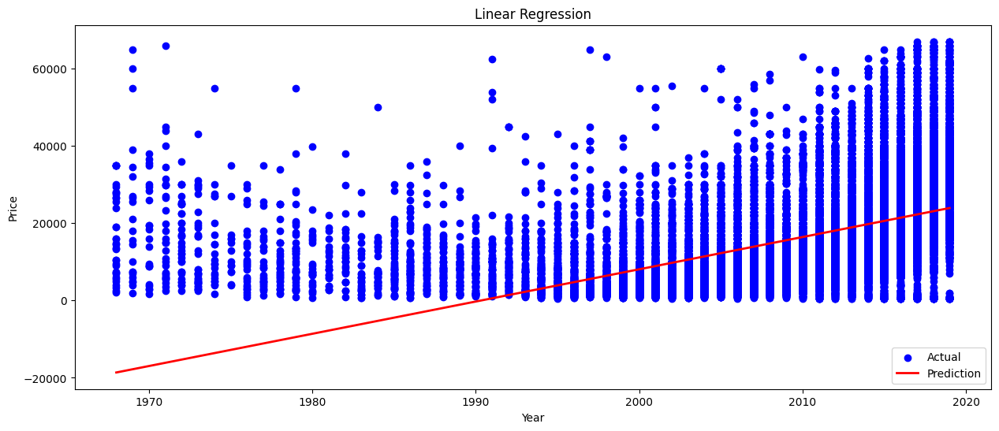

Root Mean Squared Error (RMSE) for Linear Regression with 'Year' Feature: 10933.805131557776


In [49]:
# Simple linear regression on year
X_train, X_test, y_train, y_test = train_test_split(X_numeric[['year']], y_numeric, test_size=0.2, random_state=42)
linreg = LinearRegression()
linreg.fit(X_train, y_train)
y_pred = linreg.predict(X_test)
mse_year_linreg = mean_squared_error(y_test, y_pred)

sorted_idx = X_test['year'].argsort()
X_test_sorted = X_test.iloc[sorted_idx]
y_pred_sorted = y_pred[sorted_idx]

plt.figure(figsize=(15,6))
plt.scatter(X_test['year'], y_test, color='blue', label='Actual')
plt.plot(X_test_sorted['year'], y_pred_sorted, color='red', linewidth=2, label='Prediction')
plt.xlabel('Year')
plt.ylabel('Price')
plt.title('Linear Regression')
plt.legend()
plt.show()

print(f"Root Mean Squared Error (RMSE) for Linear Regression with 'Year' Feature: {np.sqrt(mse_year_linreg)}")

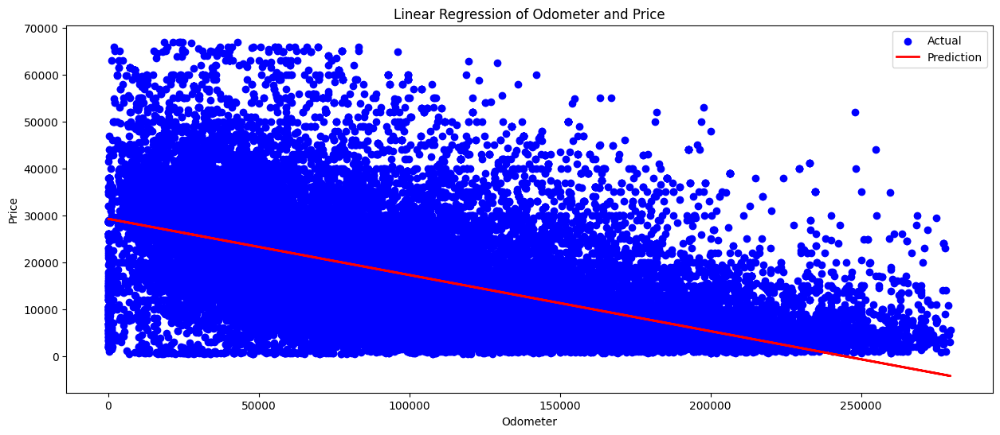

Root Mean Squared Error (RMSE) for Linear Regression with 'Odometer' Feature: 10387.787145095259


In [50]:
# Simple linear regression on odometer
X_train, X_test, y_train, y_test = train_test_split(X_numeric[['odometer']], y_numeric, test_size=0.2, random_state=42)
linreg = LinearRegression()
linreg.fit(X_train, y_train)
y_pred = linreg.predict(X_test)
mse_odometer_linreg = mean_squared_error(y_test, y_pred)

plt.figure(figsize=(15,6))
plt.scatter(X_test['odometer'], y_test, color='blue', label='Actual')
plt.plot(X_test['odometer'], y_pred, color='red', linewidth=2, label='Prediction')
plt.xlabel('Odometer')
plt.ylabel('Price')
plt.title('Linear Regression of Odometer and Price')
plt.legend()
plt.show()

print(f"Root Mean Squared Error (RMSE) for Linear Regression with 'Odometer' Feature: {np.sqrt(mse_odometer_linreg)}")

In [51]:
# Lets see if a multiple linear regression could improve our RMSE.
X_train, X_test, y_train, y_test = train_test_split(X_numeric, y_numeric, test_size=0.2, random_state=42)
multiple_linreg = LinearRegression()
multiple_linreg.fit(X_train, y_train)
y_pred = multiple_linreg.predict(X_test)

rmse_multiple_linreg = np.sqrt(mean_squared_error(y_test, y_pred))
print(f"Root Mean Squared Error (RMSE) for Multiple Linear Regression with numeric features: {rmse_multiple_linreg}")

Root Mean Squared Error (RMSE) for Multiple Linear Regression with numeric features: 8207.91027818974


### Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high-quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight into drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

In [52]:
# Comparing our RMSE scored for our different models.
print(f"RMSE for Linear Regression with 'Year' Feature: {np.sqrt(mse_year_linreg)}")
print(f"RMSE for Linear Regression with 'Odometer' Feature: {np.sqrt(mse_odometer_linreg)}")
print(f"RMSE for Multiple Linear Regression with numeric features: {rmse_multiple_linreg}")

RMSE for Linear Regression with 'Year' Feature: 10933.805131557776
RMSE for Linear Regression with 'Odometer' Feature: 10387.787145095259
RMSE for Multiple Linear Regression with numeric features: 8207.91027818974


The above cells shows us that we acheived the lowest RMSE score while using multiple linear regression.

In [53]:
# list of all the columns with a dtype == 'object' (isolates our categorical variables)
object_columns = clean_df.select_dtypes(include=['object']).columns.tolist()
object_columns

['region',
 'manufacturer',
 'model',
 'condition',
 'fuel',
 'title_status',
 'transmission',
 'drive',
 'type',
 'paint_color',
 'state']

In [54]:
clean_df[object_columns].nunique().sort_values(ascending=False)

,0
model,14496
region,404
state,51
manufacturer,41
type,14
paint_color,13
condition,7
title_status,6
fuel,5
drive,4


In [55]:
# We are going to drop the model, region, and state features due to their high cardinality.
clean_df = clean_df.drop(columns=['model', 'region', 'state'])

In [56]:
clean_df[clean_df.select_dtypes(include=['object']).columns.tolist()].nunique().sort_values(ascending=False)

,0
manufacturer,41
type,14
paint_color,13
condition,7
title_status,6
fuel,5
drive,4
transmission,3


In [57]:
# Making our dummy variables
X_categorical = pd.get_dummies(clean_df, drop_first=True)
y_categorical = clean_df['price']

In [58]:
# Standardizing
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_categorical)

In [59]:
# Separate Datasets
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_categorical, test_size=0.2, random_state=42)

In [60]:
# We are going to use PCA to help with dimensionality reduction
pca = PCA(n_components=0.95) # Varience at 95% to balance between overfitting and over-simplicity
X_train_pca = pca.fit_transform(X_train)
X_test_pca = pca.transform(X_test)

In [61]:
# Using Sequential Feature selection to limit our number of features.
linreg_sfs = LinearRegression()
selector = SequentialFeatureSelector(linreg_sfs, n_features_to_select=5, direction='forward')
selector.fit(X_train_pca, y_train)
X_train_sfs = selector.transform(X_train_pca)
X_test_sfs = selector.transform(X_test_pca)

In [62]:
# Using GridSearchCV for optimizing Ridge and Lasso Regressions.

# Building parameter grid
parameter_grid = {'alpha': [0.001, 0.01, 0.1, 1, 10, 100]}

# Creating GridSearchCV instances
ridge = GridSearchCV(Ridge(), parameter_grid, cv=5)
lasso = GridSearchCV(Lasso(), parameter_grid, cv=5)

# Training models
ridge.fit(X_train_sfs, y_train)
lasso.fit(X_train_sfs, y_train)

# Making predictions
lasso_preds = lasso.predict(X_test_sfs)
ridge_preds = ridge.predict(X_test_sfs)

In [63]:
# Evaluate Performance of Ridge vs Lasso Models


ridge_mse = mean_squared_error(y_test, ridge_preds) # Calculating MSE and RSME
ridge_rsme = np.sqrt(ridge_mse)
lasso_mse = mean_squared_error(y_test, lasso_preds)
lasso_rsme = np.sqrt(lasso_mse)

# Printing results
print(f"MSE for Ridge Regression: {ridge_mse}")
print(f"MSE for Lasso Regression: {lasso_mse}")
print(f"RMSE for Ridge Regression: {ridge_rsme}")
print(f"RMSE for Lasso Regression: {lasso_rsme}")

MSE for Ridge Regression: 38630861.56264425
MSE for Lasso Regression: 38630852.417741925
RMSE for Ridge Regression: 6215.3730026961575
RMSE for Lasso Regression: 6215.372267028092


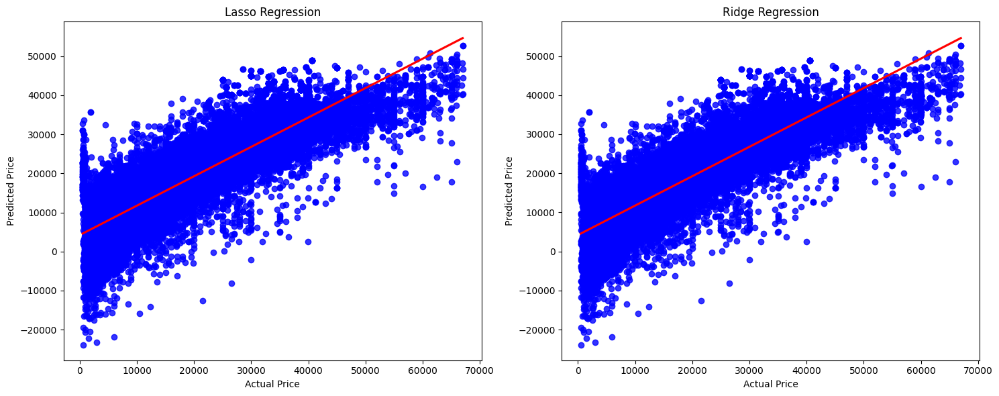

In [64]:
# Side by side subplots comparing the Actual vs predicted for Lasso and Ridge

fig, ax = plt.subplots(1,2, figsize=(15,6)) # Figure with 1 row and 2 columns

sns.regplot(x=y_test, y=lasso_preds, ax=ax[0], scatter_kws={'color': 'blue'}, line_kws={'color': 'red'})
ax[0].set_title('Lasso Regression')
ax[0].set_xlabel('Actual Price')
ax[0].set_ylabel('Predicted Price')

sns.regplot(x=y_test, y=ridge_preds, ax=ax[1], scatter_kws={'color': 'blue'}, line_kws={'color': 'red'})
ax[1].set_title('Ridge Regression')
ax[1].set_xlabel('Actual Price')
ax[1].set_ylabel('Predicted Price')

plt.tight_layout()

plt.show()

### Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine-tuning their inventory.

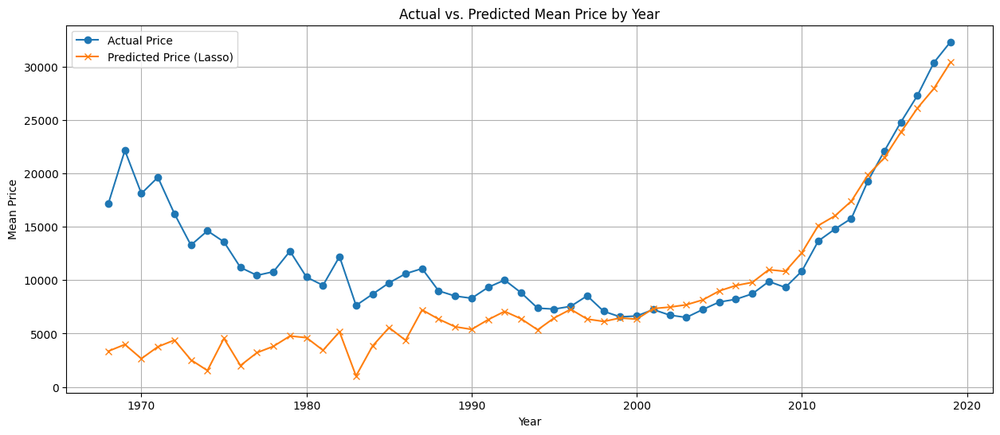

In [68]:
# Create a DataFrame for the visualization
results_df = pd.DataFrame({'Actual Price': y_test, 'Predicted Price (Lasso)': lasso_preds})

# Group data by year for mean values
results_by_year = results_df.groupby(clean_df['year']).mean()

# Create the plot
plt.figure(figsize=(15, 6))
plt.plot(results_by_year.index, results_by_year['Actual Price'], label='Actual Price', marker='o')
plt.plot(results_by_year.index, results_by_year['Predicted Price (Lasso)'], label='Predicted Price (Lasso)', marker='x')

plt.xlabel('Year')
plt.ylabel('Mean Price')
plt.title('Actual vs. Predicted Mean Price by Year')
plt.legend()
plt.grid(True)
plt.show()


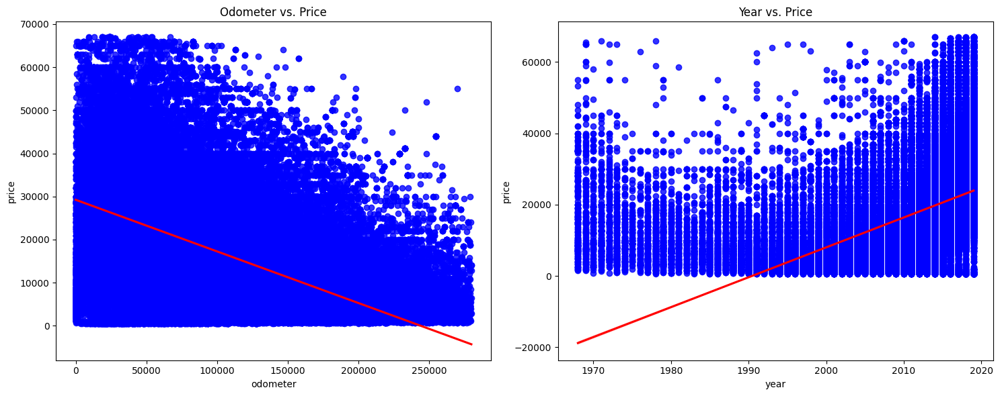

In [72]:
# Create the subplots
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

# Subplot 1: Odometer vs. Price
sns.regplot(x='odometer', y='price', data=clean_df, ax=axes[0], scatter_kws={"color": "blue"}, line_kws={"color": "red"})
axes[0].set_title('Odometer vs. Price')

# Subplot 2: Year vs. Price
sns.regplot(x='year', y='price', data=clean_df, ax=axes[1], scatter_kws={"color": "blue"}, line_kws={"color": "red"})
axes[1].set_title('Year vs. Price')


plt.tight_layout()
plt.show()
